In [ ]:
# https://www.kaggle.com/c/diabetic-retinopathy-detection/

In [2]:
import pandas as pd
import numpy as np
import os
from PIL import Image as PILImage
%matplotlib inline
from IPython.display import display, Image

In [3]:
df = pd.read_csv('../datasets/trainLabels.csv')

In [4]:
df.groupby(["level"]).count()

,image
level,
0,25810
1,2443
2,5292
3,873
4,708


<AxesSubplot:xlabel='level'>

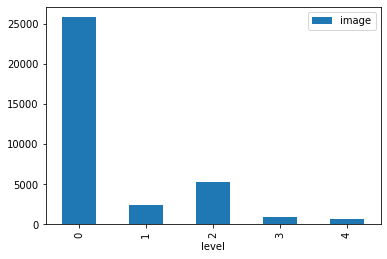

In [5]:
df.groupby(["level"]).count().plot(kind='bar')

0 - No DR
1 - Mild
2 - Moderate
3 - Severe
4 - Proliferative DR

Images are labeled with a subject id as well as either left or right (e.g. 1_left.jpeg is the left eye of patient id 1).

In [6]:
df['patient_id'] = df.image.apply(lambda x : x.split("_")[0])
df['eye'] = df.image.apply(lambda x : x.split("_")[1])

In [7]:
df

,image,level,patient_id,eye
0,10_left,0,10,left
1,10_right,0,10,right
2,13_left,0,13,left
3,13_right,0,13,right
4,15_left,1,15,left
...,...,...,...,...
35121,44347_right,0,44347,right
35122,44348_left,0,44348,left
35123,44348_right,0,44348,right
35124,44349_left,0,44349,left


In [8]:
df.groupby(["eye"])['image'].count()

eye
left     17563
right    17563
Name: image, dtype: int64

<AxesSubplot:xlabel='eye'>

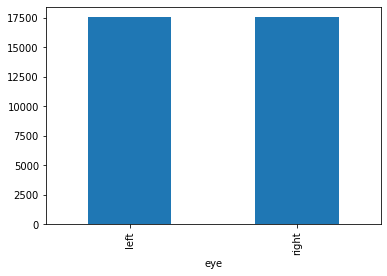

In [9]:
df.groupby(["eye"])['image'].count().plot(kind="bar")

In [10]:
image_right = PILImage.open("../datasets/sample_datasets/10_right.jpeg")

In [11]:
image_left = PILImage.open("../datasets/sample_datasets/10_left.jpeg")

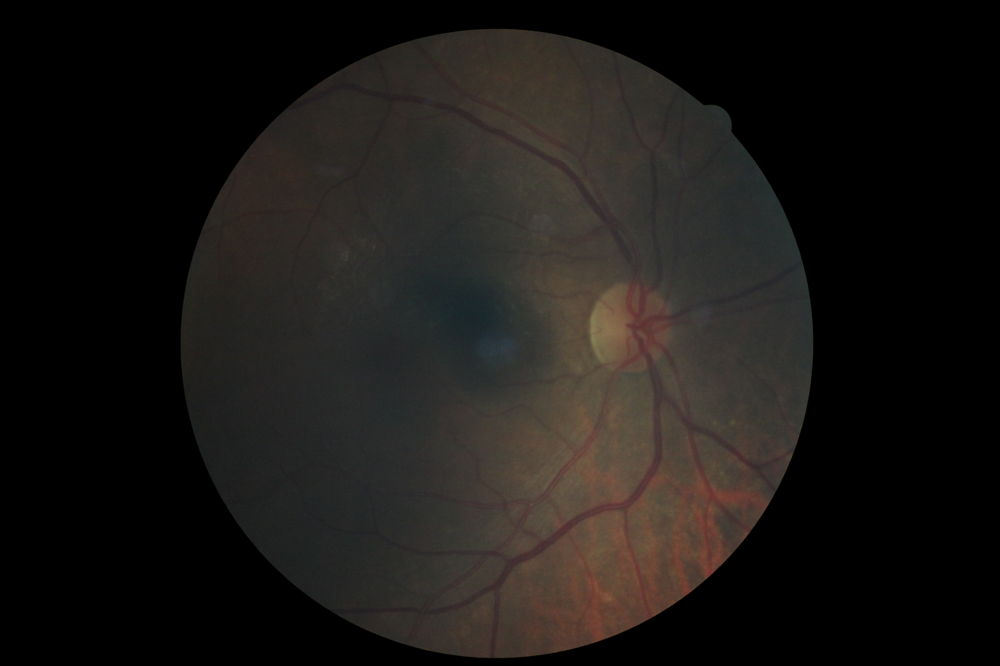

In [12]:
image_right

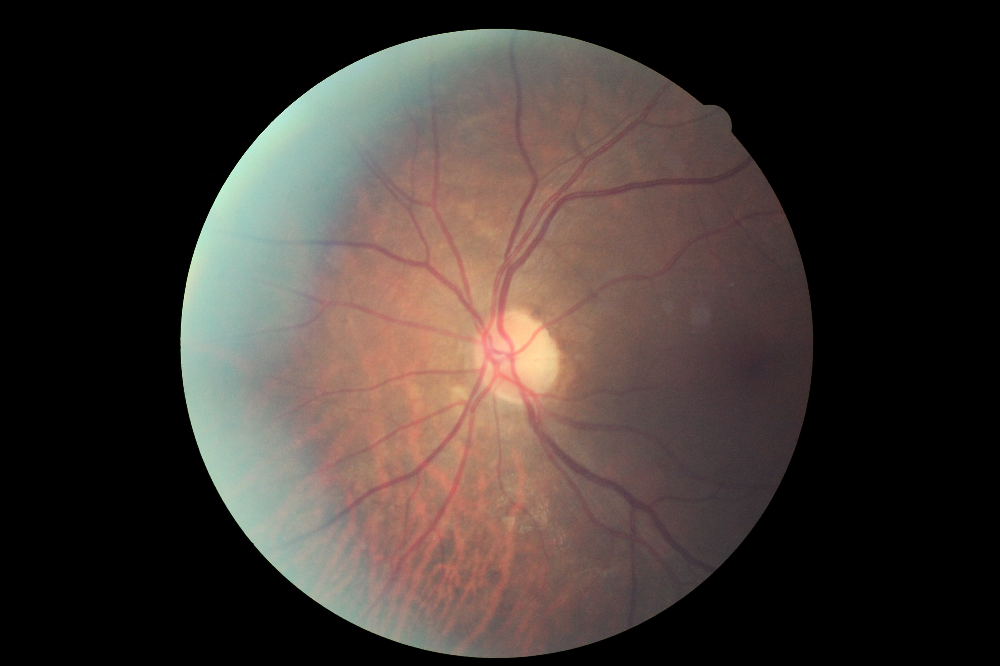

In [13]:
image_left

In [14]:
img_rows, img_cols = 200, 200

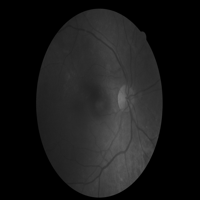

In [15]:
image_right.resize((img_rows,img_cols)).convert('L')

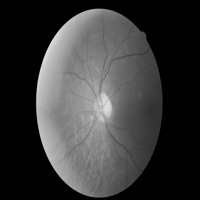

In [16]:
image_left.resize((img_rows,img_cols)).convert('L')

## Severity

In [17]:
arr = os.listdir("../datasets/sample_datasets")

In [18]:
[name.split('.')[0] for name in arr]

['15_right',
 '10_right',
 '17_right',
 '13_left',
 '15_left',
 '10_left',
 '16_left',
 '13_right',
 '16_right',
 '17_left']

In [19]:
df_sample = df[df.image.isin([name.split('.')[0] for name in arr])]

In [20]:
sam_img_list = df_sample.drop_duplicates(["level"]).image.to_list()

In [21]:
 df_sample.drop_duplicates(["level"])

,image,level,patient_id,eye
0,10_left,0,10,left
4,15_left,1,15,left
5,15_right,2,15,right
6,16_left,4,16,left


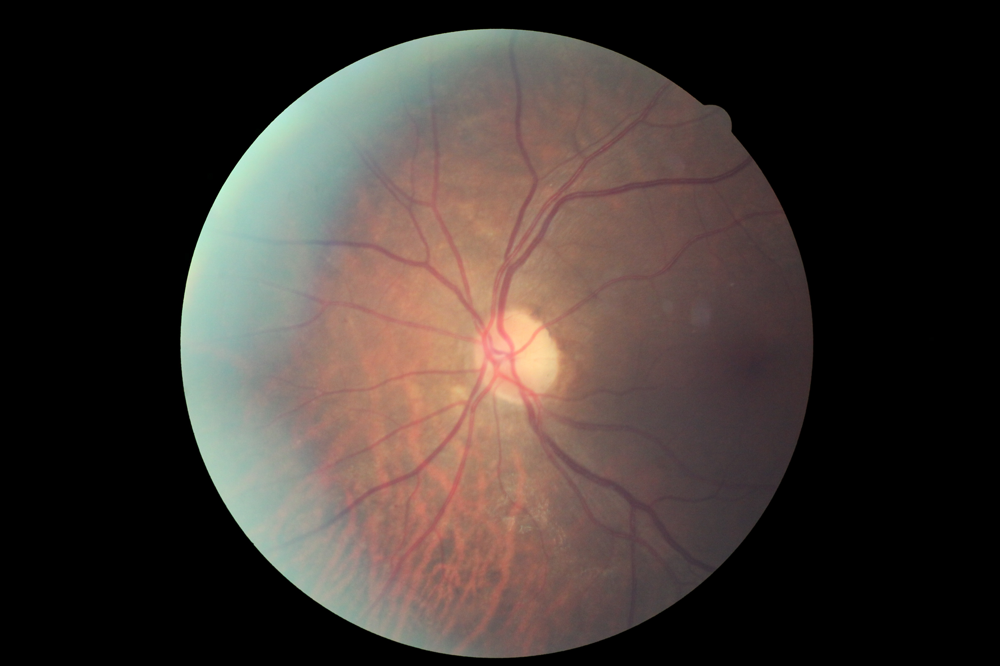

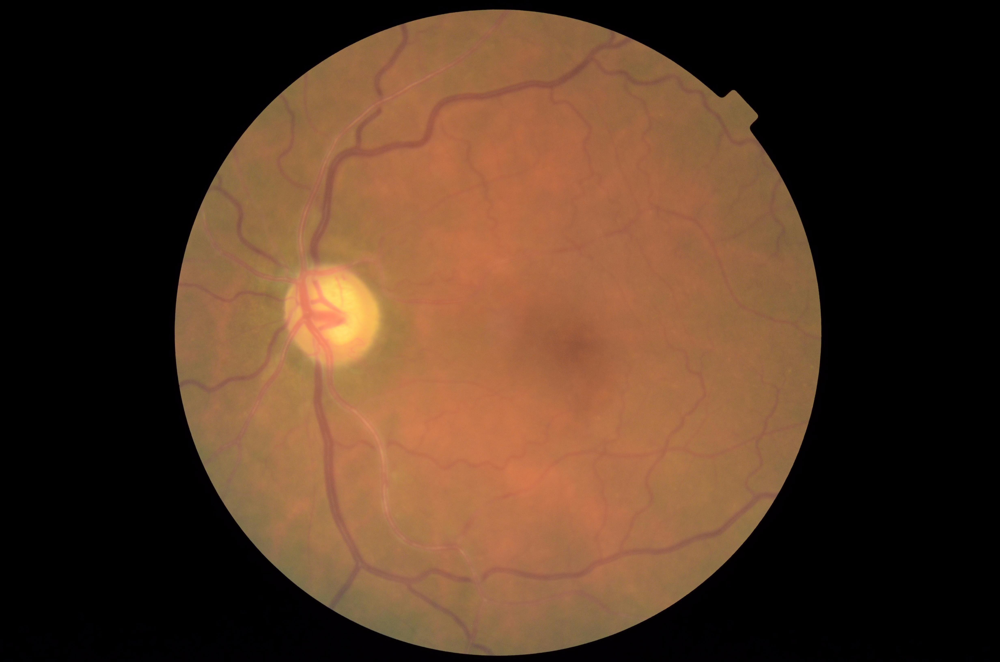

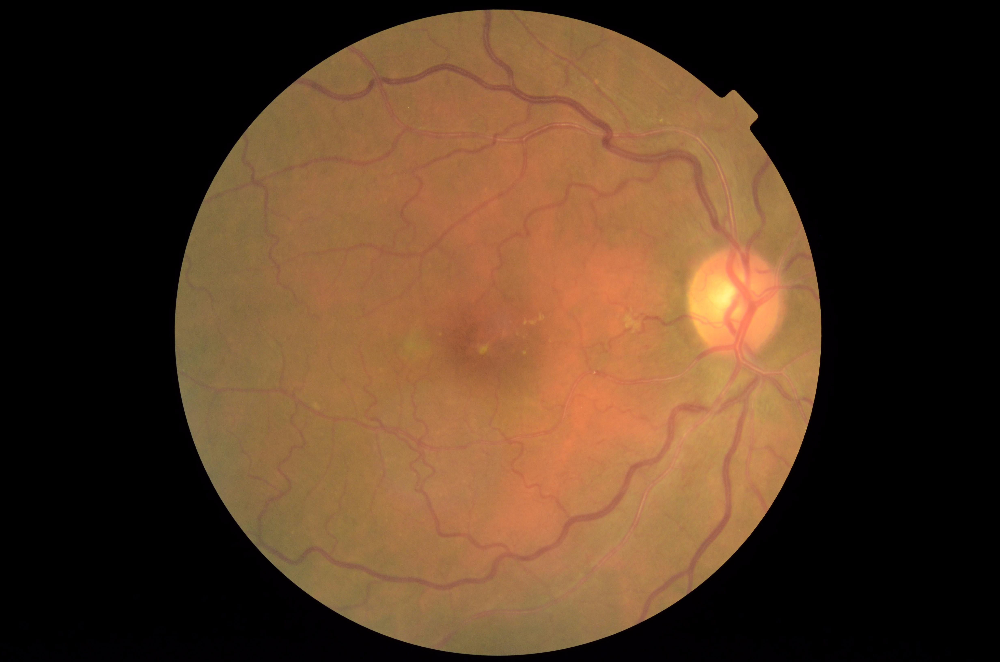

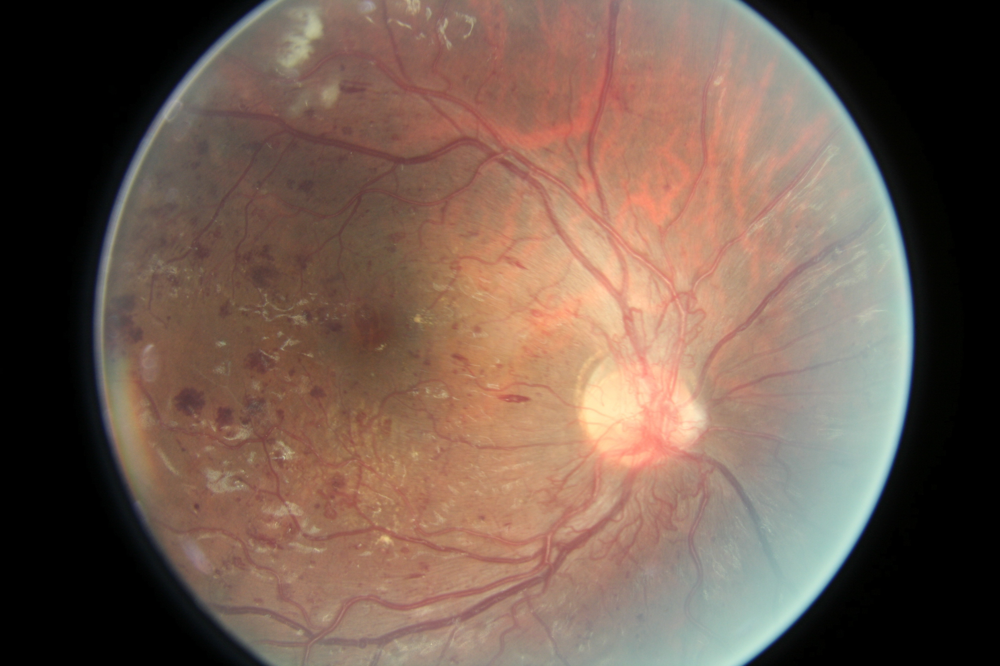

In [23]:
for img in sam_img_list:
    display(Image("../datasets/sample_datasets/"+img+".jpeg"))

In [31]:
df.image.apply(lambda x:"../input/diabetic-retinopathy-detection/"+x+".jpeg")

0        ../input/diabetic-retinopathy-detection/10_lef...
1        ../input/diabetic-retinopathy-detection/10_rig...
2        ../input/diabetic-retinopathy-detection/13_lef...
3        ../input/diabetic-retinopathy-detection/13_rig...
4        ../input/diabetic-retinopathy-detection/15_lef...
                               ...                        
35121    ../input/diabetic-retinopathy-detection/44347_...
35122    ../input/diabetic-retinopathy-detection/44348_...
35123    ../input/diabetic-retinopathy-detection/44348_...
35124    ../input/diabetic-retinopathy-detection/44349_...
35125    ../input/diabetic-retinopathy-detection/44349_...
Name: image, Length: 35126, dtype: object